In [2]:
import numpy as np
import json
import matplotlib.pyplot as plt
from collections import defaultdict, deque

In [3]:
import os
print(os.getcwd())

/Users/xuanyuchen/Desktop/UCSD/24spring/CSE291/project/291-Query-Classification/src/plan_based/feature_extraction


In [4]:
raw_file = "../../../datasets/plans/raw/workload_100k_s1_c8220.json"
parsed_5k = "../../../datasets/plans/parsed/workload_5k_s1_c8220.json"
parsed_10k = "../../../datasets/plans/parsed/workload_10k_s1_c8220.json"

In [6]:
with open(raw_file, "r") as f:
    raw_data = json.load(f)

with open(parsed_5k, "r") as f:
    parsed_5k_plan = json.load(f)

with open(parsed_10k, "r") as f:
    parsed_10k_plan = json.load(f)

In [19]:
import re

planning_time_regex = re.compile('planning time: (?P<planning_time>\d+.\d+) ms')
ex_time_regex = re.compile('execution time: (?P<execution_time>\d+.\d+) ms')
init_plan_regex = re.compile("InitPlan \d+ \(returns \$\d\)")
join_columns_regex = re.compile('\w+\.\w+ ?= ?\w+\.\w+')

In [7]:
#### runtime statistics

## for parsed plan
def runtime_statistics(plans):
  runtime = []
  for i in range(len(plans)):
    runtime.append(plans[i]['plan_runtime'])

  return min(runtime), max(runtime), sum(runtime)/len(runtime), runtime

min_runtime_5k, max_runtime_5k, mean_runtime_5k, run_5k = runtime_statistics(parsed_5k_plan['parsed_plans'])
min_runtime_10k, max_runtime_10k, mean_runtime_10k, run_10k = runtime_statistics(parsed_10k_plan['parsed_plans'])

In [8]:
## for raw plain statement
plain_statement_10k = []
runtime_all = []

count = 0

for i in range(len(raw_data['query_list'])):
  query = raw_data['query_list'][i]
  sql_text = query['sql']
  # print(i, "\n")
  # print(query['analyze_plans'])
  if not query['analyze_plans'] == []:
    runtime_text = query['analyze_plans'][0][-1][0]
    runtime = float(re.search(r'(\d+\.\d+)\s*ms', runtime_text).group(1))
    # print(sql_text, runtime_text)

    if runtime >= 100 and runtime <= 30000:
      data_entry = {"sql": sql_text, "runtime_ms": runtime}
      # runtime_list.append(runtime)
      runtime_all.append(runtime)

      if count < 10000 and runtime == run_10k[count]:
        plain_statement_10k.append(data_entry)
        count += 1
  
# for entry in test_:
#     print(entry)

print(len(plain_statement_10k), len(raw_data['query_list']))

10000 15413


In [9]:
# with open('../../plain_statement_10000.json', 'w') as json_file:
#     json.dump(plain_statement_10k, json_file, indent=4)

In [10]:
print(min_runtime_10k, max_runtime_10k, mean_runtime_10k, len(run_10k))

100.017 29932.898 4308.366410100024 10000


In [11]:
bins = np.linspace(0, 30000, 11)  # 10 bins from 0 to 30000
hist_5k, _ = np.histogram(run_5k, bins=bins)
bin_perc_5k = hist_5k / len(run_5k) * 100
hist_10k, _ = np.histogram(run_10k, bins=bins)
bin_perc_10k = hist_10k / len(run_10k) * 100
hist_all, _ = np.histogram(runtime_all, bins=bins)
bin_perc_all = hist_all / len(runtime_all) * 100

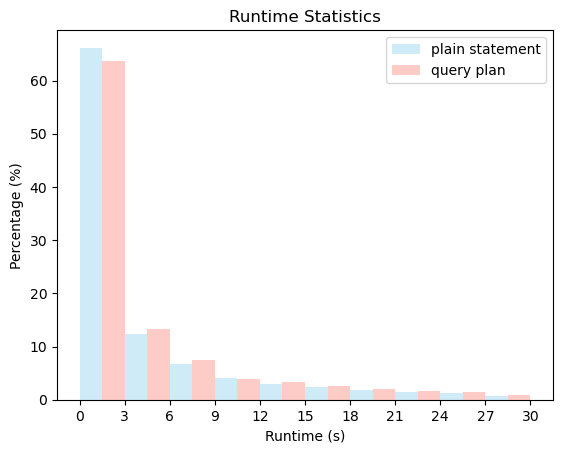

In [12]:
bin_width = bins[1] - bins[0]

# Define x positions for the bars
x_positions1 = bins[:-1]  # Shift left by bin_width/4
x_positions2 = bins[:-1] + bin_width/2  # Shift right by bin_width/4

#### plantime statistics
plt.bar(x_positions1, bin_perc_all, width=bin_width/2, align='edge', alpha=0.4, label='plain statement', color='skyblue')
plt.bar(x_positions2, bin_perc_5k, width=bin_width/2, align='edge', alpha=0.4, label='query plan', color='salmon')
# plt.bar(x_positions2,  bin_perc_10k, width=bin_width/2, align='center', alpha=0.4, label='10k', color='salmon')
plt.title("Runtime Statistics")
plt.xlabel("Runtime (s)")
plt.ylabel("Percentage (%)")  # Include '%' sign
plt.legend()

plt.xticks(bins, [int(x/1000) for x in bins])

plt.show()

In [151]:
# parsed_10k_plan['parsed_plans'][1]

In [127]:
#### parsed plans
## op_name count
## aggregation count
## filter_column operator count

op_name_count = defaultdict(int)
aggregation_count = defaultdict(int)
filter_operator_count = defaultdict(int)
plan_levels = []
table_op = defaultdict(int)
max_no_output = 0
max_no_filter = 0
node_output_count= defaultdict(int)
node_output_op = defaultdict(set)
max_count_avg = 0
max_count_sum = 0
max_count_count = 0
output_sum_col_count = defaultdict(int)
output_avg_col_count = defaultdict(int)
output_count_col_count = defaultdict(int)
output_none_col_count = defaultdict(int)
max_col_idx = -1
literal = set()

fileds = set()

idx = 0

for plan in parsed_10k_plan['parsed_plans']:
  level = 0

  queue = deque([plan])

  while queue:
    level_count = len(queue)
    while level_count > 0:
      level_count -= 1
      node = queue.popleft()
      param = node['plan_parameters']

      for key in param:
        fileds.add(key)

      op_name_count[param['op_name']] += 1

      if 'table' in param:
        table_op[param['op_name']] += 1
        # print(param)

        # table field is just an integer
        # print("Plan idx: ", idx, "Table field:", param['table'], "\n")

      if 'output_columns' in param:
        max_no_output = max(max_no_output, len(param['output_columns']))
        node_output_count[len(param['output_columns'])] += 1
        # if len(param['output_columns']) == 9:
        #   print(param['output_columns'])
        count_sum, count_avg, count_count = 0, 0, 0
        for output in param['output_columns']:
          aggregation_count[output['aggregation']] += 1
          node_output_op[len(param['output_columns'])].add(output['aggregation'])

          if len(output['columns']) != 0:
            max_col_idx = max(max_col_idx, max(output['columns']))

          if output['aggregation'] == 'SUM':
            count_sum += 1
            output_sum_col_count[len(output['columns'])] += 1
          elif output['aggregation'] == 'AVG':
            count_avg += 1
            output_avg_col_count[len(output['columns'])] += 1
          elif output['aggregation'] == 'COUNT':
            count_count += 1
            output_count_col_count[len(output['columns'])] += 1
          elif output['aggregation'] == 'None':
            output_none_col_count[len(output['columns'])] += 1
          else:
            print("Unknown aggregation", output['aggregation'])
        
        # print(idx, len(param['output_columns']), count_sum, count_avg, count_count)
        max_count_sum = max(max_count_sum, count_sum)
        max_count_avg = max(max_count_avg, count_avg)
        max_count_count = max(max_count_count, count_count)

        # if count_sum == 3:
        #   print(param['output_columns'])
      
      if 'filter_columns' in param:
        # print(param['filter_columns'])
        op = param['filter_columns']['operator']
        literal.add(param['filter_columns']['literal'])
        filter_operator_count[op] += 1
        if op == "AND":
          # print(param['filter_columns'])
          max_no_filter = max(max_no_filter, len(param['filter_columns']['children']))
          # if len(param['filter_columns']['children']) == 5:
          #   print(param['filter_columns']['children'])
          for filters in param['filter_columns']['children']:
            # if filters == "AND":
            #   print("Children in children")
            filter_operator_count[filters['operator']] += 1
            literal.add(filters['literal'])

            if len(filters['children']) != 0:
              print(filters)
        if op == "OR":
          print("OR operations seen!")

      for children in node['children']:
        queue.append(children)

    level += 1

  idx += 1
  plan_levels.append(level)

{'table': 6, 'op_name': 'Seq Scan', 'est_startup_cost': 0.0, 'est_cost': 44845.0, 'est_card': 1382674.0, 'est_width': 12.0, 'act_startup_cost': 0.036, 'act_time': 494.915, 'act_card': 1383339.0, 'filter_columns': {'column': 37, 'operator': '>=', 'literal': 11703.0, 'literal_feature': 0, 'children': []}, 'output_columns': [{'aggregation': 'None', 'columns': [36]}, {'aggregation': 'None', 'columns': [37]}, {'aggregation': 'None', 'columns': [38]}, {'aggregation': 'None', 'columns': [39]}, {'aggregation': 'None', 'columns': [40]}, {'aggregation': 'None', 'columns': [41]}, {'aggregation': 'None', 'columns': [42]}, {'aggregation': 'None', 'columns': [43]}, {'aggregation': 'None', 'columns': [44]}], 'act_children_card': 1, 'est_children_card': 1, 'workers_planned': 0}
Plan idx:  0 Table field: 6 

{'table': 0, 'op_name': 'Seq Scan', 'est_startup_cost': 0.0, 'est_cost': 1.25, 'est_card': 25.0, 'est_width': 4.0, 'act_startup_cost': 0.02, 'act_time': 0.024, 'act_card': 25.0, 'output_columns': [

In [143]:
print(fileds)

{'est_card', 'table', 'op_name', 'act_time', 'act_card', 'est_width', 'workers_planned', 'est_startup_cost', 'act_startup_cost', 'filter_columns', 'est_cost', 'act_children_card', 'est_children_card', 'output_columns'}


In [67]:
attr_pattern = r'^\w+\.\w+$'

In [71]:
literal_type = set()
for l in literal:
  if isinstance(l, str):
    l = l.strip()
    if re.match(attr_pattern, l):
      print(l)

part.p_partkey
supplier.s_nationkey
partsupp.ps_partkey
nation.n_regionkey
partsupp.ps_suppkey
orders.o_custkey
lineitem.l_orderkey
orders.o_orderkey
customer.c_custkey
region.r_regionkey
nation.n_nationkey
lineitem.l_suppkey
lineitem.l_partkey
supplier.s_suppkey


In [58]:
print(node_output_count)
print(node_output_op)

defaultdict(<class 'int'>, {1: 38197, 2: 36005, 9: 3847, 3: 22856, 4: 11071, 8: 455, 5: 7652, 16: 2545, 7: 2498, 6: 1281})
defaultdict(<class 'set'>, {1: {'AVG', 'SUM', 'COUNT', 'None'}, 2: {'AVG', 'SUM', 'COUNT', 'None'}, 9: {'None'}, 3: {'AVG', 'SUM', 'COUNT', 'None'}, 4: {'None'}, 8: {'None'}, 5: {'None'}, 16: {'None'}, 7: {'None'}, 6: {'None'}})


In [150]:
print(max_no_filter)

5


In [7]:
# parsed_5k_plan['parsed_plans'][1293]
parsed_5k_plan['parsed_plans'][0]

{'plain_content': [],
 'plan_parameters': {'op_name': 'Aggregate',
  'est_startup_cost': 470058.46,
  'est_cost': 470058.47,
  'est_card': 1.0,
  'est_width': 8.0,
  'act_startup_cost': 12196.367,
  'act_time': 12196.61,
  'act_card': 1.0,
  'output_columns': [{'aggregation': 'SUM', 'columns': [37, 43]}],
  'act_children_card': 2250782.0,
  'est_children_card': 636.0,
  'workers_planned': 0},
 'children': [{'plain_content': [],
   'plan_parameters': {'op_name': 'Hash Join',
    'est_startup_cost': 420018.89,
    'est_cost': 470055.28,
    'est_card': 636.0,
    'est_width': 8.0,
    'act_startup_cost': 6984.563,
    'act_time': 11945.785,
    'act_card': 2250782.0,
    'filter_columns': {'column': 36,
     'operator': '=',
     'literal': 'lineitem.l_orderkey  ',
     'literal_feature': 0,
     'children': []},
    'output_columns': [{'aggregation': 'None', 'columns': [37]},
     {'aggregation': 'None', 'columns': [43]}],
    'act_children_card': 3375446760408.0,
    'est_children_card

In [148]:
# for key in parsed_5k_plan:
#   print(key)

In [147]:
# for key in parsed_5k_plan['database_stats']:
#   print(key)

In [144]:
# parsed_5k_plan['database_stats']['column_stats']

In [17]:
# parsed_5k_plan['database_stats']['table_stats']

{'plain_content': [],
 'plan_parameters': {'op_name': 'Aggregate',
  'est_startup_cost': 42268.64,
  'est_cost': 42268.65,
  'est_card': 1.0,
  'est_width': 8.0,
  'act_startup_cost': 133.386,
  'act_time': 144.088,
  'act_card': 1.0,
  'output_columns': [{'aggregation': 'COUNT', 'columns': []}],
  'act_children_card': 10.0,
  'est_children_card': 11.0,
  'workers_planned': 0},
 'children': [{'plain_content': [],
   'plan_parameters': {'op_name': 'Hash Join',
    'est_startup_cost': 6648.28,
    'est_cost': 42268.62,
    'est_card': 11.0,
    'est_width': 0.0,
    'act_startup_cost': 19.572,
    'act_time': 144.074,
    'act_card': 10.0,
    'filter_columns': {'column': 37,
     'operator': '=',
     'literal': 'customer.c_custkey  ',
     'literal_feature': 0,
     'children': []},
    'act_children_card': 1733745.0,
    'est_children_card': 1618864.0,
    'workers_planned': 0},
   'children': [{'plain_content': [],
     'plan_parameters': {'op_name': 'Gather',
      'est_startup_cost

In [24]:
parsed_5k_plan['parsed_plans'][1293]['plan_runtime']

144.182

In [27]:
root = parsed_5k_plan['parsed_plans'][1293]
level = 0

queue = deque([root])

while queue:
  level_count = len(queue)
  print("\n")
  print("Level", level)
  while level_count > 0:
    level_count -= 1
    node = queue.popleft()
    # print(node['plan_parameters'])
    print(node)

    for children in node['children']:
      queue.append(children)

  level += 1



Level 0
{'plain_content': [], 'plan_parameters': {'op_name': 'Aggregate', 'est_startup_cost': 42268.64, 'est_cost': 42268.65, 'est_card': 1.0, 'est_width': 8.0, 'act_startup_cost': 133.386, 'act_time': 144.088, 'act_card': 1.0, 'output_columns': [{'aggregation': 'COUNT', 'columns': []}], 'act_children_card': 10.0, 'est_children_card': 11.0, 'workers_planned': 0}, 'children': [{'plain_content': [], 'plan_parameters': {'op_name': 'Hash Join', 'est_startup_cost': 6648.28, 'est_cost': 42268.62, 'est_card': 11.0, 'est_width': 0.0, 'act_startup_cost': 19.572, 'act_time': 144.074, 'act_card': 10.0, 'filter_columns': {'column': 37, 'operator': '=', 'literal': 'customer.c_custkey  ', 'literal_feature': 0, 'children': []}, 'act_children_card': 1733745.0, 'est_children_card': 1618864.0, 'workers_planned': 0}, 'children': [{'plain_content': [], 'plan_parameters': {'op_name': 'Gather', 'est_startup_cost': 1000.0, 'est_cost': 36614.8, 'est_card': 1448.0, 'est_width': 4.0, 'act_startup_cost': 0.36,

In [26]:
# root = parsed_5k_plan['parsed_plans'][1293]
root = parsed_5k_plan['parsed_plans'][1294]
level = 0

queue = deque([root])

while queue:
  level_count = len(queue)
  print("\n")
  print("Level", level)
  while level_count > 0:
    level_count -= 1
    node = queue.popleft()
    # print(node['plan_parameters'])
    print(node)

    for children in node['children']:
      queue.append(children)

  level += 1



Level 0
{'plain_content': [], 'plan_parameters': {'op_name': 'Finalize Aggregate', 'est_startup_cost': 63987.49, 'est_cost': 63987.5, 'est_card': 1.0, 'est_width': 72.0, 'act_startup_cost': 631.066, 'act_time': 633.511, 'act_card': 1.0, 'output_columns': [{'aggregation': 'AVG', 'columns': [37, 43]}, {'aggregation': 'AVG', 'columns': [39]}, {'aggregation': 'COUNT', 'columns': []}], 'act_children_card': 3.0, 'est_children_card': 2.0, 'workers_planned': 0}, 'children': [{'plain_content': [], 'plan_parameters': {'op_name': 'Gather', 'est_startup_cost': 63987.25, 'est_cost': 63987.46, 'est_card': 2.0, 'est_width': 72.0, 'act_startup_cost': 631.039, 'act_time': 633.49, 'act_card': 3.0, 'workers_planned': 0, 'output_columns': [{'aggregation': 'AVG', 'columns': [37, 43]}, {'aggregation': 'AVG', 'columns': [39]}, {'aggregation': 'COUNT', 'columns': []}], 'act_children_card': 1.0, 'est_children_card': 1.0}, 'children': [{'plain_content': [], 'plan_parameters': {'op_name': 'Partial Aggregate', 

In [74]:
import json

In [86]:
with open("../../../datasets/stats/column_statistics.json") as f:
  col_stat = json.load(f)

In [112]:
col_stat_complete = dict()

In [96]:
col_idx_map = dict()

In [121]:
data_type = set()

In [122]:
col_idx = 0

for table in col_stat:
  cols = col_stat[table]
  for col in cols:
    col_dict = dict()
    col_name = table + "." + col
    col_idx_map[col_idx] = col_name
    
    col_idx += 1
    # print(cols[col])
    col_dict['nan_ratio'] = cols[col]['nan_ratio']
    col_dict['datatype'] = cols[col]['datatype']
    data_type.add(col_dict['datatype'])
    if cols[col]['datatype'] != 'misc':
      col_dict['num_unique'] = cols[col]['num_unique']
    col_stat_complete[col_name] = col_dict
   

In [123]:
data_type

{'categorical', 'float', 'int', 'misc'}

In [119]:
col_stat_complete

{'nation.n_nationkey': {'nan_ratio': 0.0, 'datatype': 'int', 'num_unique': 25},
 'nation.n_name': {'nan_ratio': 0.0,
  'datatype': 'categorical',
  'num_unique': 25},
 'nation.n_regionkey': {'nan_ratio': 0.0, 'datatype': 'int', 'num_unique': 5},
 'nation.n_comment': {'nan_ratio': 0.0,
  'datatype': 'categorical',
  'num_unique': 25},
 'region.r_regionkey': {'nan_ratio': 0.0, 'datatype': 'int', 'num_unique': 5},
 'region.r_name': {'nan_ratio': 0.0,
  'datatype': 'categorical',
  'num_unique': 5},
 'region.r_comment': {'nan_ratio': 0.0,
  'datatype': 'categorical',
  'num_unique': 5},
 'part.p_partkey': {'nan_ratio': 0.0, 'datatype': 'int', 'num_unique': 200000},
 'part.p_name': {'nan_ratio': 0.0, 'datatype': 'misc'},
 'part.p_mfgr': {'nan_ratio': 0.0, 'datatype': 'categorical', 'num_unique': 5},
 'part.p_brand': {'nan_ratio': 0.0,
  'datatype': 'categorical',
  'num_unique': 25},
 'part.p_type': {'nan_ratio': 0.0,
  'datatype': 'categorical',
  'num_unique': 150},
 'part.p_size': {'nan_

In [105]:
col_stat_supp = parsed_5k_plan['database_stats']['column_stats']

In [124]:
for col in col_stat_supp:
  col_name = col['tablename'] + "." + col['attname']
  col_stat_complete[col_name]['n_distinct'] = col['n_distinct']
  col_stat_complete[col_name]['avg_width'] = col['avg_width']
  col_stat_complete[col_name]['corr_with_row'] = col['correlation']
  col_stat_complete[col_name]['table_size'] = col['table_size']
  # print(col)

In [125]:
col_stat_complete

{'nation.n_nationkey': {'nan_ratio': 0.0,
  'datatype': 'int',
  'num_unique': 25,
  'n_distinct': -1.0,
  'avg_width': 4,
  'corr_with_row': 1.0,
  'table_size': 25.0},
 'nation.n_name': {'nan_ratio': 0.0,
  'datatype': 'categorical',
  'num_unique': 25,
  'n_distinct': -1.0,
  'avg_width': 26,
  'corr_with_row': 0.913077,
  'table_size': 25.0},
 'nation.n_regionkey': {'nan_ratio': 0.0,
  'datatype': 'int',
  'num_unique': 5,
  'n_distinct': -0.2,
  'avg_width': 4,
  'corr_with_row': 0.347692,
  'table_size': 25.0},
 'nation.n_comment': {'nan_ratio': 0.0,
  'datatype': 'categorical',
  'num_unique': 25,
  'n_distinct': -1.0,
  'avg_width': 75,
  'corr_with_row': 0.0784615,
  'table_size': 25.0},
 'region.r_regionkey': {'nan_ratio': 0.0,
  'datatype': 'int',
  'num_unique': 5,
  'n_distinct': -1.0,
  'avg_width': 4,
  'corr_with_row': 1.0,
  'table_size': 5.0},
 'region.r_name': {'nan_ratio': 0.0,
  'datatype': 'categorical',
  'num_unique': 5,
  'n_distinct': -1.0,
  'avg_width': 26,


In [98]:
col_idx_map

{0: 'nation.n_nationkey',
 1: 'nation.n_name',
 2: 'nation.n_regionkey',
 3: 'nation.n_comment',
 4: 'region.r_regionkey',
 5: 'region.r_name',
 6: 'region.r_comment',
 7: 'part.p_partkey',
 8: 'part.p_name',
 9: 'part.p_mfgr',
 10: 'part.p_brand',
 11: 'part.p_type',
 12: 'part.p_size',
 13: 'part.p_container',
 14: 'part.p_retailprice',
 15: 'part.p_comment',
 16: 'supplier.s_suppkey',
 17: 'supplier.s_name',
 18: 'supplier.s_address',
 19: 'supplier.s_nationkey',
 20: 'supplier.s_phone',
 21: 'supplier.s_acctbal',
 22: 'supplier.s_comment',
 23: 'partsupp.ps_partkey',
 24: 'partsupp.ps_suppkey',
 25: 'partsupp.ps_availqty',
 26: 'partsupp.ps_supplycost',
 27: 'partsupp.ps_comment',
 28: 'customer.c_custkey',
 29: 'customer.c_name',
 30: 'customer.c_address',
 31: 'customer.c_nationkey',
 32: 'customer.c_phone',
 33: 'customer.c_acctbal',
 34: 'customer.c_mktsegment',
 35: 'customer.c_comment',
 36: 'orders.o_orderkey',
 37: 'orders.o_custkey',
 38: 'orders.o_orderstatus',
 39: 'orde

In [129]:
col_stat_complete[col_idx_map[20]]

{'nan_ratio': 0.0,
 'datatype': 'categorical',
 'num_unique': 10000,
 'n_distinct': -1.0,
 'avg_width': 16,
 'corr_with_row': 0.0065122,
 'table_size': 10000.0}

In [130]:
parsed_5k_plan['database_stats']['table_stats']

[{'relname': 'nation', 'reltuples': 25.0, 'relpages': 1},
 {'relname': 'region', 'reltuples': 5.0, 'relpages': 1},
 {'relname': 'part', 'reltuples': 200000.0, 'relpages': 4097},
 {'relname': 'supplier', 'reltuples': 10000.0, 'relpages': 222},
 {'relname': 'partsupp', 'reltuples': 800000.0, 'relpages': 17451},
 {'relname': 'customer', 'reltuples': 150000.0, 'relpages': 3585},
 {'relname': 'orders', 'reltuples': 1500000.0, 'relpages': 26095},
 {'relname': 'lineitem', 'reltuples': 6001800.0, 'relpages': 112503},
 {'relname': 'pg_statistic', 'reltuples': 454.0, 'relpages': 31},
 {'relname': 'pg_type', 'reltuples': 391.0, 'relpages': 9},
 {'relname': 'pg_policy', 'reltuples': 0.0, 'relpages': 0},
 {'relname': 'pg_authid', 'reltuples': 6.0, 'relpages': 1},
 {'relname': 'pg_user_mapping', 'reltuples': 0.0, 'relpages': 0},
 {'relname': 'pg_subscription', 'reltuples': 0.0, 'relpages': 0},
 {'relname': 'pg_attribute', 'reltuples': 2688.0, 'relpages': 49},
 {'relname': 'pg_proc', 'reltuples': 289

In [131]:
table_stat_complete = dict()
table_idx_map = dict()
table_idx = 0

for table_stat in parsed_5k_plan['database_stats']['table_stats']:
  table_dict = dict()
  table_name = table_stat['relname']
  table_idx_map[table_idx] = table_name
  table_dict['reltuples'] = table_stat['reltuples']
  table_dict['relpages'] = table_stat['relpages']
  table_stat_complete[table_name] = table_dict
  table_idx += 1

In [133]:
table_stat_complete

{'nation': {'reltuples': 25.0, 'relpages': 1},
 'region': {'reltuples': 5.0, 'relpages': 1},
 'part': {'reltuples': 200000.0, 'relpages': 4097},
 'supplier': {'reltuples': 10000.0, 'relpages': 222},
 'partsupp': {'reltuples': 800000.0, 'relpages': 17451},
 'customer': {'reltuples': 150000.0, 'relpages': 3585},
 'orders': {'reltuples': 1500000.0, 'relpages': 26095},
 'lineitem': {'reltuples': 6001800.0, 'relpages': 112503},
 'pg_statistic': {'reltuples': 454.0, 'relpages': 31},
 'pg_type': {'reltuples': 391.0, 'relpages': 9},
 'pg_policy': {'reltuples': 0.0, 'relpages': 0},
 'pg_authid': {'reltuples': 6.0, 'relpages': 1},
 'pg_user_mapping': {'reltuples': 0.0, 'relpages': 0},
 'pg_subscription': {'reltuples': 0.0, 'relpages': 0},
 'pg_attribute': {'reltuples': 2688.0, 'relpages': 49},
 'pg_proc': {'reltuples': 2894.0, 'relpages': 74},
 'pg_class': {'reltuples': 349.0, 'relpages': 11},
 'pg_attrdef': {'reltuples': 0.0, 'relpages': 0},
 'pg_constraint': {'reltuples': 2.0, 'relpages': 1},


In [134]:
stat_complete = []
stat_complete.append(col_idx_map)
stat_complete.append(col_stat_complete)
stat_complete.append(table_idx_map)
stat_complete.append(table_stat_complete)

In [136]:
stat_complete[1]

{'nation.n_nationkey': {'nan_ratio': 0.0,
  'datatype': 'int',
  'num_unique': 25,
  'n_distinct': -1.0,
  'avg_width': 4,
  'corr_with_row': 1.0,
  'table_size': 25.0},
 'nation.n_name': {'nan_ratio': 0.0,
  'datatype': 'categorical',
  'num_unique': 25,
  'n_distinct': -1.0,
  'avg_width': 26,
  'corr_with_row': 0.913077,
  'table_size': 25.0},
 'nation.n_regionkey': {'nan_ratio': 0.0,
  'datatype': 'int',
  'num_unique': 5,
  'n_distinct': -0.2,
  'avg_width': 4,
  'corr_with_row': 0.347692,
  'table_size': 25.0},
 'nation.n_comment': {'nan_ratio': 0.0,
  'datatype': 'categorical',
  'num_unique': 25,
  'n_distinct': -1.0,
  'avg_width': 75,
  'corr_with_row': 0.0784615,
  'table_size': 25.0},
 'region.r_regionkey': {'nan_ratio': 0.0,
  'datatype': 'int',
  'num_unique': 5,
  'n_distinct': -1.0,
  'avg_width': 4,
  'corr_with_row': 1.0,
  'table_size': 5.0},
 'region.r_name': {'nan_ratio': 0.0,
  'datatype': 'categorical',
  'num_unique': 5,
  'n_distinct': -1.0,
  'avg_width': 26,


In [138]:
with open('stat_complete.json', 'w') as f:
  json.dump(stat_complete, f)

In [139]:
with open('stat_complete.json', 'r') as f:
  stat_complete_test = json.load(f)

In [142]:
type(stat_complete_test[0])

dict

In [104]:
for key in parsed_5k_plan['database_stats']:
  print(key)

column_stats
table_stats


In [137]:
parsed_5k_plan['database_stats']['column_stats']

[{'tablename': 'nation',
  'attname': 'n_nationkey',
  'null_frac': 0.0,
  'avg_width': 4,
  'n_distinct': -1.0,
  'correlation': 1.0,
  'data_type': 'integer',
  'table_size': 25.0},
 {'tablename': 'nation',
  'attname': 'n_name',
  'null_frac': 0.0,
  'avg_width': 26,
  'n_distinct': -1.0,
  'correlation': 0.913077,
  'data_type': 'character',
  'table_size': 25.0},
 {'tablename': 'nation',
  'attname': 'n_regionkey',
  'null_frac': 0.0,
  'avg_width': 4,
  'n_distinct': -0.2,
  'correlation': 0.347692,
  'data_type': 'integer',
  'table_size': 25.0},
 {'tablename': 'nation',
  'attname': 'n_comment',
  'null_frac': 0.0,
  'avg_width': 75,
  'n_distinct': -1.0,
  'correlation': 0.0784615,
  'data_type': 'character varying',
  'table_size': 25.0},
 {'tablename': 'region',
  'attname': 'r_regionkey',
  'null_frac': 0.0,
  'avg_width': 4,
  'n_distinct': -1.0,
  'correlation': 1.0,
  'data_type': 'integer',
  'table_size': 5.0},
 {'tablename': 'region',
  'attname': 'r_name',
  'null_fr